In [1]:
import numpy as np
import pandas as pd
import requests
import datetime as dt
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from pyproj import Proj,transform
from folium.plugins import FastMarkerCluster
from folium.plugins import MarkerCluster
from sklearn.cluster import DBSCAN

In [2]:
dataframe = pd.read_csv('parking-citations.csv',nrows=50000)

In [3]:
dataframe.head(10)

,Ticket number,Issue Date,Issue time,Meter Id,Marked Time,RP State Plate,Plate Expiry Date,VIN,Make,Body Style,Color,Location,Route,Agency,Violation code,Violation Description,Fine amount,Latitude,Longitude
0,1103341116,2015-12-21T00:00:00,1251.0,NaN,NaN,CA,200304.0,NaN,HOND,PA,GY,13147 WELBY WAY,01521,1.0,4000A1,NO EVIDENCE OF REG,50.0,99999.0,99999.0
1,1103700150,2015-12-21T00:00:00,1435.0,NaN,NaN,CA,201512.0,NaN,GMC,VN,WH,525 S MAIN ST,1C51,1.0,4000A1,NO EVIDENCE OF REG,50.0,99999.0,99999.0
2,1104803000,2015-12-21T00:00:00,2055.0,NaN,NaN,CA,201503.0,NaN,NISS,PA,BK,200 WORLD WAY,2R2,2.0,8939,WHITE CURB,58.0,6439997.9,1802686.4
3,1104820732,2015-12-26T00:00:00,1515.0,NaN,NaN,CA,NaN,NaN,ACUR,PA,WH,100 WORLD WAY,2F11,2.0,000,17104h,NaN,6440041.1,1802686.2
4,1105461453,2015-09-15T00:00:00,115.0,NaN,NaN,CA,200316.0,NaN,CHEV,PA,BK,GEORGIA ST/OLYMPIC,1FB70,1.0,8069A,NO STOPPING/STANDING,93.0,99999.0,99999.0
5,1106226590,2015-09-15T00:00:00,19.0,NaN,NaN,CA,201507.0,NaN,CHEV,VN,GY,SAN PEDRO S/O BOYD,1A35W,1.0,4000A1,NO EVIDENCE OF REG,50.0,99999.0,99999.0
6,1106500452,2015-12-17T00:00:00,1710.0,NaN,NaN,CA,201605.0,NaN,MAZD,PA,BL,SUNSET/ALVARADO,00217,1.0,8070,PARK IN GRID LOCK ZN,163.0,99999.0,99999.0
7,1106500463,2015-12-17T00:00:00,1710.0,NaN,NaN,CA,201602.0,NaN,TOYO,PA,BK,SUNSET/ALVARADO,00217,1.0,8070,PARK IN GRID LOCK ZN,163.0,99999.0,99999.0
8,1106506402,2015-12-22T00:00:00,945.0,NaN,NaN,CA,201605.0,NaN,CHEV,PA,BR,721 S WESTLAKE,2A75,1.0,8069AA,NO STOP/STAND AM,93.0,99999.0,99999.0
9,1106506413,2015-12-22T00:00:00,1100.0,NaN,NaN,CA,201701.0,NaN,NISS,PA,SI,1159 HUNTLEY DR,2A75,1.0,8069AA,NO STOP/STAND AM,93.0,99999.0,99999.0


Since our primary focus is the location and type of violation along with the fine amount, we can disregard information such as Marked date and time, Plate expiry date, VIN, Make, Body style etc. We would keep the fine amount to get a sense of the amount of money being collected as fine to get a better idea on financial scale.

In [4]:
dataframe = dataframe.drop(['Ticket number','Meter Id','Marked Time','RP State Plate','Plate Expiry Date','Make','VIN','Body Style','Color','Route','Agency'],axis=1)

In [5]:
# dataframe = dataframe.dropna()
dataframe.head()

,Issue Date,Issue time,Location,Violation code,Violation Description,Fine amount,Latitude,Longitude
0,2015-12-21T00:00:00,1251.0,13147 WELBY WAY,4000A1,NO EVIDENCE OF REG,50.0,99999.0,99999.0
1,2015-12-21T00:00:00,1435.0,525 S MAIN ST,4000A1,NO EVIDENCE OF REG,50.0,99999.0,99999.0
2,2015-12-21T00:00:00,2055.0,200 WORLD WAY,8939,WHITE CURB,58.0,6439997.9,1802686.4
3,2015-12-26T00:00:00,1515.0,100 WORLD WAY,000,17104h,NaN,6440041.1,1802686.2
4,2015-09-15T00:00:00,115.0,GEORGIA ST/OLYMPIC,8069A,NO STOPPING/STANDING,93.0,99999.0,99999.0


As we can see, we have dates and times on a timestamp and a 24 hour format. So the next thing we do is to see the data types of each column and try to convert it into a suitable form fo our analysis.

In [6]:
dataframe.dtypes

Issue Date                object
Issue time               float64
Location                  object
Violation code            object
Violation Description     object
Fine amount              float64
Latitude                 float64
Longitude                float64
dtype: object

Since the date in the column is in IS08601 standard and we only need the year,month and the day,we are going to parse it to remove the time part from the data.

In [7]:
dataframe['Issue Date'] = pd.to_datetime(dataframe['Issue Date'], dayfirst=True)

In [8]:
dataframe = dataframe.sort_values(by='Issue Date')
dataframe.head()

,Issue Date,Issue time,Location,Violation code,Violation Description,Fine amount,Latitude,Longitude
19199,2012-12-30,1253.0,812 N SWEETZER AV,011,22500F,68.0,99999.0,99999.0
27281,2013-01-02,712.0,550 S RAMPART,8056E2,YELLOW ZONE,58.0,99999.0,99999.0
27065,2015-01-02,1329.0,652 E GAGE AV,8056E4,RED ZONE,93.0,99999.0,99999.0
27059,2015-01-02,1002.0,201 E 43RD ST,8056E4,RED ZONE,93.0,99999.0,99999.0
27058,2015-01-02,1000.0,204 E 43RD ST,8056E4,RED ZONE,93.0,99999.0,99999.0


The next thing for us would be to conver the issue time from a 24 hour format and a float data type.

In [9]:
dataframe['Issue time'].isna().sum()

13

In [10]:
dataframe = dataframe.dropna(subset=['Issue time'])
dataframe['Issue time'] = dataframe['Issue time'].astype(int)

In [11]:
# dataframe = dataframe[99965:99968]

In [12]:
dataframe['Issue time'] = dataframe['Issue time'].apply(str)
for i,time in enumerate(dataframe['Issue time']):
#     print(time)
    length = len(time)
    if(length==1):
        time="000"+ time
    elif(length==2):
        time = "00" + time
    elif(length==3):
        time = "0"+ time
    else:
        time = time
#       
    dataframe.at[i,"Issue time"] = time


In [13]:
# dataframe = dataframe[dataframe['Issue time'].str.contains(':')]

In [14]:
dataframe['Issue time']=pd.to_datetime(dataframe['Issue time'],format ='%H%M').dt.time

In [15]:
dataframe.head()

,Issue Date,Issue time,Location,Violation code,Violation Description,Fine amount,Latitude,Longitude
19199,2012-12-30,07:26:00,812 N SWEETZER AV,011,22500F,68.0,99999.0,99999.0
27281,2013-01-02,14:10:00,550 S RAMPART,8056E2,YELLOW ZONE,58.0,99999.0,99999.0
27065,2015-01-02,15:34:00,652 E GAGE AV,8056E4,RED ZONE,93.0,99999.0,99999.0
27059,2015-01-02,15:13:00,201 E 43RD ST,8056E4,RED ZONE,93.0,99999.0,99999.0
27058,2015-01-02,13:25:00,204 E 43RD ST,8056E4,RED ZONE,93.0,99999.0,99999.0


We now try to bring a hypothesis into our analysis. We pick a specific time duration which is considered to be a rush hour and try to see if the count of parking citations are in any way correlated to the number of citations.

In [16]:
from datetime import time
msrush = time(5,0,0)
merush = time(10,0,0)
esrush = time(16,0,0)
eerush = time(21,0,0)
print(msrush)
print(merush)
print(esrush)
print(eerush)

05:00:00
10:00:00
16:00:00
21:00:00


In [17]:
dataframe['Rush hour'] = np.where(((dataframe['Issue time']>msrush) & (dataframe['Issue time']<merush)) | ((dataframe['Issue time']>esrush) & (dataframe['Issue time']<eerush)),"1","0")

In [18]:
dataframe.head()

,Issue Date,Issue time,Location,Violation code,Violation Description,Fine amount,Latitude,Longitude,Rush hour
19199,2012-12-30,07:26:00,812 N SWEETZER AV,011,22500F,68.0,99999.0,99999.0,1
27281,2013-01-02,14:10:00,550 S RAMPART,8056E2,YELLOW ZONE,58.0,99999.0,99999.0,0
27065,2015-01-02,15:34:00,652 E GAGE AV,8056E4,RED ZONE,93.0,99999.0,99999.0,0
27059,2015-01-02,15:13:00,201 E 43RD ST,8056E4,RED ZONE,93.0,99999.0,99999.0,0
27058,2015-01-02,13:25:00,204 E 43RD ST,8056E4,RED ZONE,93.0,99999.0,99999.0,0


Exploring more into the database we now try to look various types of violation code and the number of offences commited.

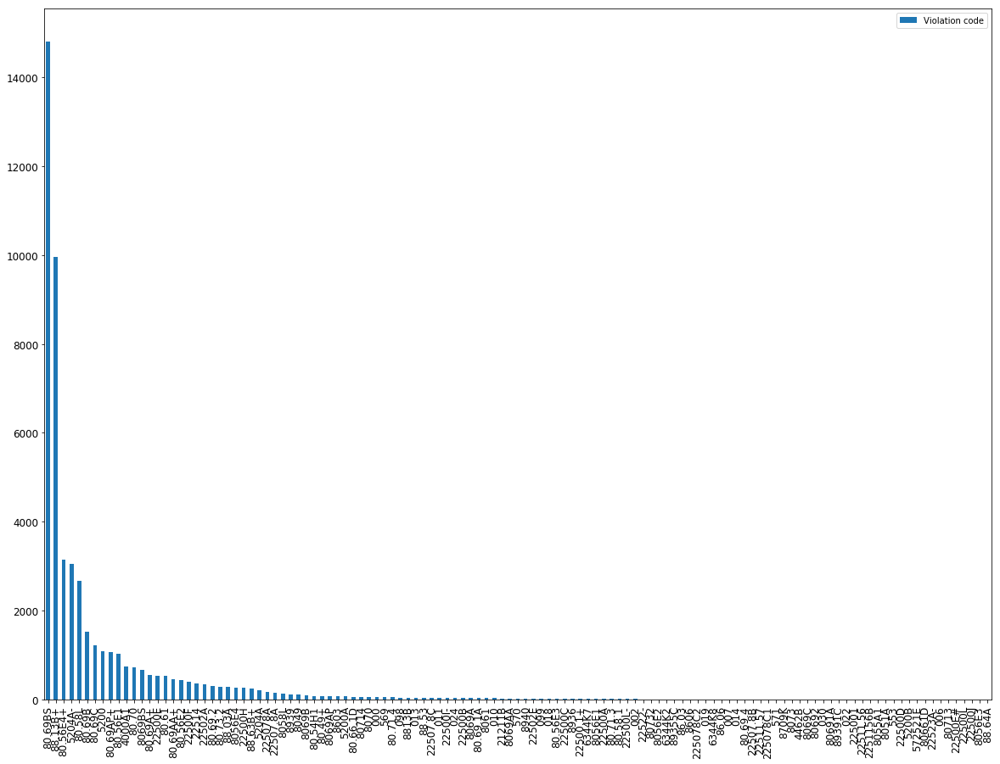

In [19]:
counts = pd.DataFrame(dataframe['Violation code'].value_counts())
counts.plot(kind='bar',figsize=(20,15),fontsize=12)

The top 10 Violations are:


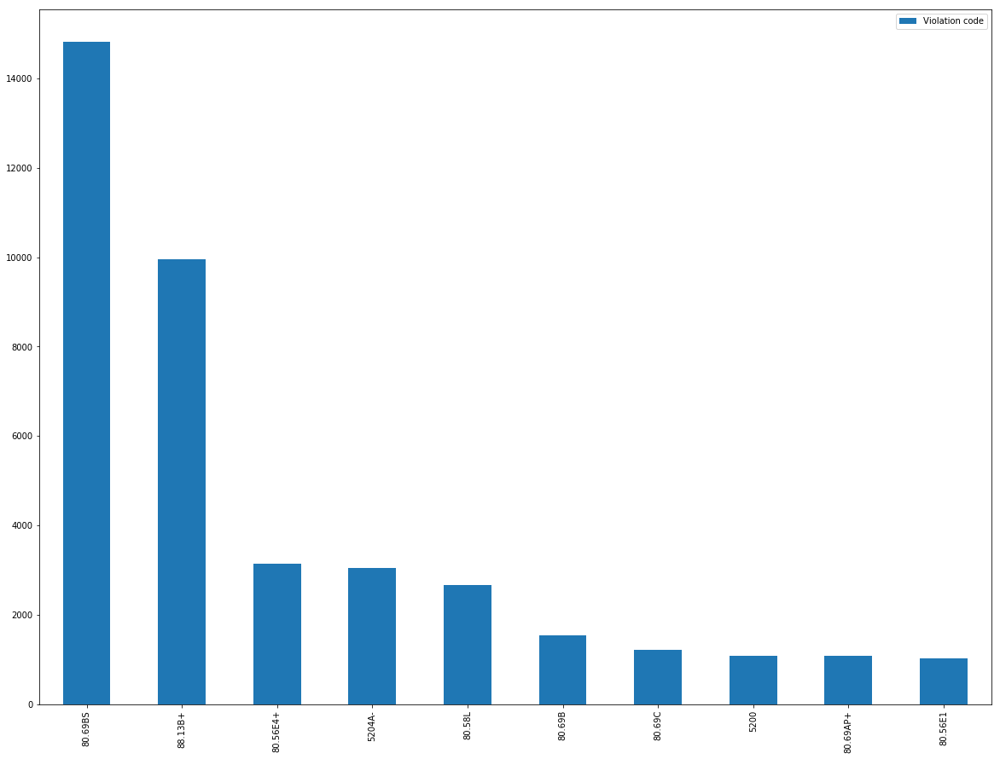

In [20]:
print("The top 10 Violations are:")
counts[0:10].plot(kind='bar',figsize=(20,15))

We now compare the number of rush hour violation to the number of number of non rush hour violation

In [21]:
RushDF = pd.DataFrame(dataframe['Rush hour'].value_counts())
RushDF.index=['No Rush','Rush']

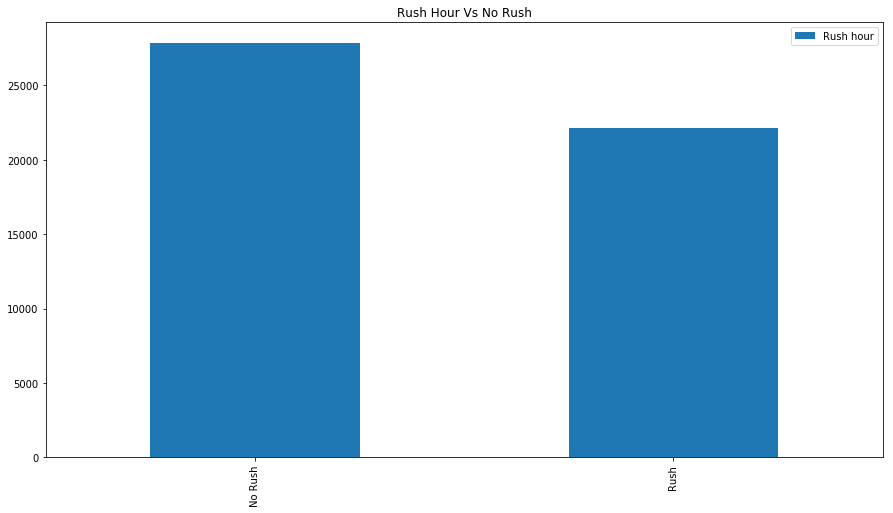

In [22]:
RushDF.plot(kind='bar', title ="Rush Hour Vs No Rush",figsize=(15,8))

As we can see some of the Fine amount have NaN as the value, our next approach would be to deal with those values. There are multiple ways to deal with this. One of the option would be to remove the values with NaN out of our analysis but it might lead us to miss out on other important information. Another way to handle the day, which we are going to use is to fill the NaN with the average fine across the parking citations.

In [23]:
n_rows = dataframe.shape[0]
meanFine = dataframe['Fine amount'].mean()
print(meanFine)
for i in range(0,n_rows):
    if np.isnan(dataframe['Fine amount'][i]) == True:
        dataframe['Fine amount'][i] = meanFine

71.76346045989905


/home/sazack/.local/lib/python3.6/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [24]:
dataframe = dataframe.dropna()
dataframe.head()

,Issue Date,Issue time,Location,Violation code,Violation Description,Fine amount,Latitude,Longitude,Rush hour
19199,2012-12-30,07:26:00,812 N SWEETZER AV,011,22500F,68.0,99999.0,99999.0,1
27281,2013-01-02,14:10:00,550 S RAMPART,8056E2,YELLOW ZONE,58.0,99999.0,99999.0,0
27065,2015-01-02,15:34:00,652 E GAGE AV,8056E4,RED ZONE,93.0,99999.0,99999.0,0
27059,2015-01-02,15:13:00,201 E 43RD ST,8056E4,RED ZONE,93.0,99999.0,99999.0,0
27058,2015-01-02,13:25:00,204 E 43RD ST,8056E4,RED ZONE,93.0,99999.0,99999.0,0


Total Amount spent in Fines: 3586894


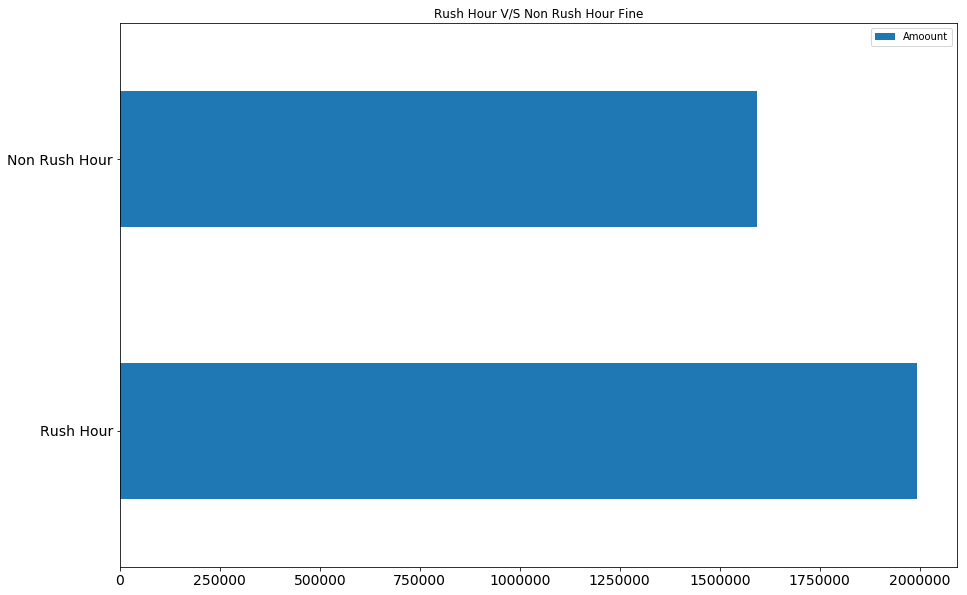

In [25]:
dataframe['Fine amount'] = dataframe['Fine amount'].round(0).astype(int)
rushfine = dataframe[dataframe['Rush hour'] =="0"]['Fine amount'].values.sum()
nrushfine = dataframe[dataframe['Rush hour'] =="1"]['Fine amount'].values.sum()
print("Total Amount spent in Fines:", rushfine + nrushfine )
fineDF = pd.DataFrame([rushfine,nrushfine])
fineDF.index=['Rush Hour','Non Rush Hour']
fineDF.columns=['Amoount']
fineDF.plot(kind = 'barh', figsize=(15,10), title="Rush Hour V/S Non Rush Hour Fine", fontsize=14)

In [26]:
start2013 = dt.datetime(2013,1,1)
end2013 = dt.datetime(2013,12,31)
start2014 = dt.datetime(2014,1,1)
end2014 = dt.datetime(2014,12,31)
start2015 = dt.datetime(2015,1,1)
end2015 = dt.datetime(2015,12,31)
start2016 = dt.datetime(2016,1,1)
end2016 = dt.datetime(2016,12,31)
start2017 = dt.datetime(2017,1,1)
end2017 = dt.datetime(2017,12,31)
# print(start2015,end2015)

In [27]:
dataframe.dtypes

Issue Date               datetime64[ns]
Issue time                       object
Location                         object
Violation code                   object
Violation Description            object
Fine amount                       int64
Latitude                        float64
Longitude                       float64
Rush hour                        object
dtype: object

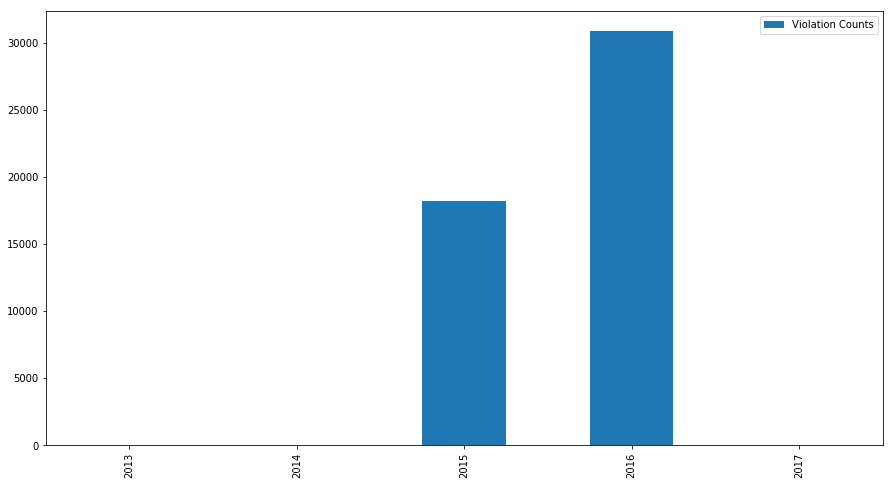

In [28]:
data2013 = dataframe[(dataframe['Issue Date']> start2013) & (dataframe['Issue Date']<= end2013)].shape[0]
data2014 = dataframe[(dataframe['Issue Date']> start2014) & (dataframe['Issue Date']<= end2014)].shape[0]
data2015 = dataframe[(dataframe['Issue Date']> start2015) & (dataframe['Issue Date']<= end2015)].shape[0]
data2016 = dataframe[(dataframe['Issue Date']> start2016) & (dataframe['Issue Date']<= end2016)].shape[0]
data2017 = dataframe[(dataframe['Issue Date']> start2017) & (dataframe['Issue Date']<= end2017)].shape[0]

yearDF = pd.DataFrame([data2013,data2014,data2015,data2016,data2017])
yearDF.index =(['2013','2014','2015','2016','2017'])
yearDF.columns =(['Violation Counts'])

yearDF.plot(kind= 'bar', figsize=(15,8))

If you notice the Dataframe, the Latitude and Longitude are given on a in US Feet coordinates according to the NAD_1983_StatePlane_California_V_FIPS_0405_Feet projection. If we try and convert that, every entry with value 99999.0 lies somewhere in the Pacific ocean. So to ease our job in hand, we decided to proceed with only those coordinates whose lat long are not 99999.

In [29]:
dataframe = dataframe[dataframe['Latitude'] != 99999.0]

In [30]:
dataframe.head()

,Issue Date,Issue time,Location,Violation code,Violation Description,Fine amount,Latitude,Longitude,Rush hour
19097,2015-09-08,18:39:00,5050 MT HOLLYWOOD DR,013,22500H,68,6471016.5,1859549.6,1
19093,2015-09-10,02:28:00,3200 CANYON LAKE DR,8049,WRG SD/NOT PRL,63,6462616.8,1869105.2,0
19104,2015-09-10,03:01:00,2800 W OBSERVATORY,8056E4,RED ZONE,93,6470141.4,1867430.4,0
19105,2015-09-10,03:07:00,2800 W OBSERVATORY,8049,WRG SD/NOT PRL,63,6470141.4,1867430.4,0
19106,2015-09-10,05:59:00,2800 W OBSERVATORY,8049,WRG SD/NOT PRL,63,6470141.4,1867430.4,1


In [31]:
# lat = dataframe['Latitude'].values
# long = dataframe['Longitude'].values

In [32]:
# WGS84 = Proj(init='EPSG:4326')
# inp = Proj(init='EPSG:2229',preserve_units=True)
# dataframe['Longitude'],dataframe['Latitude']= transform(inp, WGS84, lat, long)

In [33]:
# dataframe = dataframe[(dataframe['Latitude'] > 34.0) & (dataframe['Latitude'] < 36.0)]

In [34]:
dataframe.head()


,Issue Date,Issue time,Location,Violation code,Violation Description,Fine amount,Latitude,Longitude,Rush hour
19097,2015-09-08,18:39:00,5050 MT HOLLYWOOD DR,013,22500H,68,6471016.5,1859549.6,1
19093,2015-09-10,02:28:00,3200 CANYON LAKE DR,8049,WRG SD/NOT PRL,63,6462616.8,1869105.2,0
19104,2015-09-10,03:01:00,2800 W OBSERVATORY,8056E4,RED ZONE,93,6470141.4,1867430.4,0
19105,2015-09-10,03:07:00,2800 W OBSERVATORY,8049,WRG SD/NOT PRL,63,6470141.4,1867430.4,0
19106,2015-09-10,05:59:00,2800 W OBSERVATORY,8049,WRG SD/NOT PRL,63,6470141.4,1867430.4,1


In [35]:
LAmap = folium.Map(location=[34.0522,-118.2437],zoom_start=10)
# LAmap

In [36]:
pm = '+proj=lcc +lat_1=34.03333333333333 +lat_2=35.46666666666667 +lat_0=33.5 +lon_0=-118 +x_0=2000000 ' \
     '+y_0=500000.0000000002 +ellps=GRS80 +datum=NAD83 +to_meter=0.3048006096012192 +no_defs'

# convert to lat/long
x_in,y_in = dataframe['Latitude'].values, dataframe['Longitude'].values
dataframe['Longitude'],dataframe['Latitude'] = transform(Proj(pm, preserve_units = True), Proj("+init=epsg:4326"), x_in,y_in)

In [37]:
dataframe.head()

,Issue Date,Issue time,Location,Violation code,Violation Description,Fine amount,Latitude,Longitude,Rush hour
19097,2015-09-08,18:39:00,5050 MT HOLLYWOOD DR,013,22500H,68,34.101760,-118.299440,1
19093,2015-09-10,02:28:00,3200 CANYON LAKE DR,8049,WRG SD/NOT PRL,63,34.127945,-118.327289,0
19104,2015-09-10,03:01:00,2800 W OBSERVATORY,8056E4,RED ZONE,93,34.123408,-118.302409,0
19105,2015-09-10,03:07:00,2800 W OBSERVATORY,8049,WRG SD/NOT PRL,63,34.123408,-118.302409,0
19106,2015-09-10,05:59:00,2800 W OBSERVATORY,8049,WRG SD/NOT PRL,63,34.123408,-118.302409,1


In [38]:
# from geopy.geocoders import Nominatim
# geolocater = Nominatim(user_agent="la_explorer")
# nolat = dataframe[dataframe['Latitude'] ==99999.0][:10]
# for i,val in enumerate(nolat['Location']):
#     val = val + ", LA, USA"
#     print(val)
#     location = geolocater.geocode(val+ "LA")
#     print(location)
# #     nolat.at[i,"Latitude"] = location.latitude
# #     nolat.at[i,"Longitude"] = location.longitude
# nolat.head()

In [39]:
# for lng, lat, location in zip(dataframe['Longitude'], dataframe['Latitude'],dataframe['Location']):
# FastMarkerCluster(data=list(zip(dataframe['Longitude'], dataframe['Latitude']))).add_to(LAmap)
    
# #     print(lat,lng,location)
#     label = '{}'.format(location)
#     label = folium.Popup(label, parse_html=True)
#     folium.CircleMarker(
#         [lat, lng],
#         radius=5,
#         popup=label,
#         color='blue',
#         fill=True,
#         fill_color='#3186cc',
#         fill_opacity=0.7).add_to(LAmap)  
    
# LAmap

In [40]:
mc = MarkerCluster()
for row in dataframe.itertuples():
    mc.add_child(folium.Marker(location =[row.Latitude,row.Longitude],popup = row.Location))

In [41]:
LAmap.add_child(mc)
LAmap

In [42]:
df_top_frequency = dataframe.groupby(['Location','Latitude', 'Longitude'])['Location'].agg(
    {"counts": len}).sort_values(
    "counts", ascending=False).head(10).reset_index()

/home/sazack/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: using a dict on a Series for aggregation
is deprecated and will be removed in a future version
  


In [43]:
df_top_frequency.head(10)

,Location,Latitude,Longitude,counts
0,4867 SUNSET BLVD W,34.098141,-118.295389,72
1,2800 E OBSERVATORY,34.123408,-118.302409,58
2,1235 FIGUEROA PL,33.782415,-118.281029,52
3,1301 ELECTRIC AVE,33.991691,-118.467910,52
4,5901 98TH ST W,33.947344,-118.385970,45
5,100 LARCHMONT BL N,34.073023,-118.323530,43
6,11601 SAN VICENTE BL,34.050751,-118.480653,42
7,101 LARCHMONT BL N,34.073023,-118.323530,35
8,2800 W OBSERVATORY,34.123408,-118.302409,35
9,2377 MIDVALE AVE,34.040144,-118.429894,35


In [44]:
CLIENT_ID = 'CNUE4BESOB1KV2MHPXRIE10RLRKXQCFOHYE2MCTS3MJSDUVI' # your Foursquare ID
CLIENT_SECRET = 'UP3N3DIWT25YMXJ4NLEPMKOZYY4VPRBSLWRCFDAKNSOZVTUT' # your Foursquare Secret
VERSION = '20190131' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: CNUE4BESOB1KV2MHPXRIE10RLRKXQCFOHYE2MCTS3MJSDUVI
CLIENT_SECRET:UP3N3DIWT25YMXJ4NLEPMKOZYY4VPRBSLWRCFDAKNSOZVTUT


In [45]:
LIMIT=20
radius = 500
categoryId = '4c38df4de52ce0d596b336e1'

In [46]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        results = requests.get(url).json()["response"]['groups'][0]['items']

        venues_list.append([(
            name, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],
            v['venue']['location']['distance'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
#                   'Neighborhood Latitude', 
#                   'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude',
                    'Distance',
                  'Venue Category']
    
    return(nearby_venues)

In [47]:
countparkings = getNearbyVenues(names=df_top_frequency['Location'],
                                   latitudes=df_top_frequency['Latitude'],
                                   longitudes=df_top_frequency['Longitude']
                                  )

Here we calculate the number of parking lots in each of the neighborhood from the highest number of violating.

In [48]:
df_top_freq = countparkings.groupby(['Neighborhood'])['Neighborhood'].agg(
    {"counts_parking": len}).sort_values(
    "counts_parking", ascending=False).head(10).reset_index()

/home/sazack/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: using a dict on a Series for aggregation
is deprecated and will be removed in a future version
  


In [49]:
df_top_freq = df_top_freq.rename(index=str, columns={'Neighborhood':'Location'})

In [50]:
finalDF = df_top_freq.merge(df_top_frequency)


In [51]:
finalDF.head(10)

,Location,counts_parking,Latitude,Longitude,counts
0,100 LARCHMONT BL N,20,34.073023,-118.323530,43
1,101 LARCHMONT BL N,20,34.073023,-118.323530,35
2,1301 ELECTRIC AVE,20,33.991691,-118.467910,52
3,2377 MIDVALE AVE,20,34.040144,-118.429894,35
4,4867 SUNSET BLVD W,20,34.098141,-118.295389,72
5,5901 98TH ST W,20,33.947344,-118.385970,45
6,2800 E OBSERVATORY,6,34.123408,-118.302409,58
7,2800 W OBSERVATORY,6,34.123408,-118.302409,35
8,1235 FIGUEROA PL,4,33.782415,-118.281029,52
9,11601 SAN VICENTE BL,2,34.050751,-118.480653,42


[]

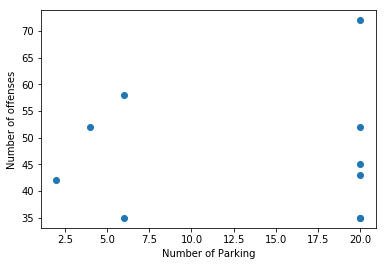

In [52]:
plt.scatter(finalDF['counts_parking'],finalDF['counts'])
plt.xlabel("Number of Parking")
plt.ylabel("Number of offenses")
plt.plot()

In [53]:
finalDF['ratio'] = finalDF['counts'] / finalDF['counts_parking']

In [54]:
finalDF.head(100)

,Location,counts_parking,Latitude,Longitude,counts,ratio
0,100 LARCHMONT BL N,20,34.073023,-118.323530,43,2.150000
1,101 LARCHMONT BL N,20,34.073023,-118.323530,35,1.750000
2,1301 ELECTRIC AVE,20,33.991691,-118.467910,52,2.600000
3,2377 MIDVALE AVE,20,34.040144,-118.429894,35,1.750000
4,4867 SUNSET BLVD W,20,34.098141,-118.295389,72,3.600000
5,5901 98TH ST W,20,33.947344,-118.385970,45,2.250000
6,2800 E OBSERVATORY,6,34.123408,-118.302409,58,9.666667
7,2800 W OBSERVATORY,6,34.123408,-118.302409,35,5.833333
8,1235 FIGUEROA PL,4,33.782415,-118.281029,52,13.000000
9,11601 SAN VICENTE BL,2,34.050751,-118.480653,42,21.000000


In [55]:
print(finalDF.loc[finalDF['ratio'].idxmax()])

Location          11601 SAN VICENTE BL
counts_parking                       2
Latitude                       34.0508
Longitude                     -118.481
counts                              42
ratio                               21
Name: 9, dtype: object
